<a href="https://colab.research.google.com/github/sunshineluyao/waiting-time-eip1559/blob/main/code/Data_Process/Analyze_Data_NFT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

The Three NFT Drops:
* Fatales NFT Launches (2021-08-31)
* Pointilla NFT drops (2021-09-09)
* GalaxyEggs NFT Launches (2021-9-14)

Start:
- date_time => 2021-08-24 00:00:00
- unix_timestamp =>  1629763200.0
- block => 13084679

End:
- date_time => 2021-09-21 00:00:00
- unix_timestamp =>  1632182400.0
- block => 13265754


# Part I: Set-up

In [25]:
pip install -U kaleido #tools for explorting figures

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [26]:
# mount google drive
from google.colab import drive

drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [27]:
# print the current directory
!pwd

/content/drive/My Drive/waitingtime


In [28]:
#@title path
#create a project folder and identify the path
path = "/content/drive/MyDrive/waitingtime" #@param {type:"string"}

In [29]:
#go to your project folder 
%cd /content/drive/MyDrive/waitingtime

/content/drive/MyDrive/waitingtime


In [30]:
# print the current directory again to make sure that you are in the project folder
!pwd 

/content/drive/MyDrive/waitingtime


In [31]:
import pandas as pd
import numpy as np

In [32]:
NFT = pd.read_pickle('NFT_blocks_selected.pkl')
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas
1,13084679,10652,30029181,2292403,1629763199,25,54817122710
7,13084680,18762,30058505,4458662,1629763201,56,49011155932
15,13084681,89606,30029152,30023592,1629763205,246,44702251913
20,13084682,166011,30000000,21704672,1629763231,210,50287964208
25,13084683,20832,30029295,2373575,1629763234,22,53097666754
...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,1632182318,320,112982041170
45259,13265751,91381,30029295,29831274,1632182357,257,127091408885
45263,13265752,81565,30000000,18945447,1632182367,187,142768317575
45262,13265753,68156,30000000,22521894,1632182388,180,147462357827


In [33]:
NFT=NFT.sort_values(by='number', ascending=True)
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas
1,13084679,10652,30029181,2292403,1629763199,25,54817122710
7,13084680,18762,30058505,4458662,1629763201,56,49011155932
15,13084681,89606,30029152,30023592,1629763205,246,44702251913
20,13084682,166011,30000000,21704672,1629763231,210,50287964208
25,13084683,20832,30029295,2373575,1629763234,22,53097666754
...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,1632182318,320,112982041170
45259,13265751,91381,30029295,29831274,1632182357,257,127091408885
45263,13265752,81565,30000000,18945447,1632182367,187,142768317575
45262,13265753,68156,30000000,22521894,1632182388,180,147462357827


In [34]:
NFT['gas_used_pct'] = NFT['gas_used']/NFT['gas_limit']
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct
1,13084679,10652,30029181,2292403,1629763199,25,54817122710,0.076339
7,13084680,18762,30058505,4458662,1629763201,56,49011155932,0.148333
15,13084681,89606,30029152,30023592,1629763205,246,44702251913,0.999815
20,13084682,166011,30000000,21704672,1629763231,210,50287964208,0.723489
25,13084683,20832,30029295,2373575,1629763234,22,53097666754,0.079042
...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,1632182318,320,112982041170,0.999526
45259,13265751,91381,30029295,29831274,1632182357,257,127091408885,0.993406
45263,13265752,81565,30000000,18945447,1632182367,187,142768317575,0.631515
45262,13265753,68156,30000000,22521894,1632182388,180,147462357827,0.750730


In [35]:
import datetime
from datetime import date
NFT['timestamp'] = pd.to_datetime(NFT['timestamp'], unit='s')
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct
1,13084679,10652,30029181,2292403,2021-08-23 23:59:59,25,54817122710,0.076339
7,13084680,18762,30058505,4458662,2021-08-24 00:00:01,56,49011155932,0.148333
15,13084681,89606,30029152,30023592,2021-08-24 00:00:05,246,44702251913,0.999815
20,13084682,166011,30000000,21704672,2021-08-24 00:00:31,210,50287964208,0.723489
25,13084683,20832,30029295,2373575,2021-08-24 00:00:34,22,53097666754,0.079042
...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,2021-09-20 23:58:38,320,112982041170,0.999526
45259,13265751,91381,30029295,29831274,2021-09-20 23:59:17,257,127091408885,0.993406
45263,13265752,81565,30000000,18945447,2021-09-20 23:59:27,187,142768317575,0.631515
45262,13265753,68156,30000000,22521894,2021-09-20 23:59:48,180,147462357827,0.750730


In [36]:
NFT['date'] =NFT['timestamp'].dt.date
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date
1,13084679,10652,30029181,2292403,2021-08-23 23:59:59,25,54817122710,0.076339,2021-08-23
7,13084680,18762,30058505,4458662,2021-08-24 00:00:01,56,49011155932,0.148333,2021-08-24
15,13084681,89606,30029152,30023592,2021-08-24 00:00:05,246,44702251913,0.999815,2021-08-24
20,13084682,166011,30000000,21704672,2021-08-24 00:00:31,210,50287964208,0.723489,2021-08-24
25,13084683,20832,30029295,2373575,2021-08-24 00:00:34,22,53097666754,0.079042,2021-08-24
...,...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,2021-09-20 23:58:38,320,112982041170,0.999526,2021-09-20
45259,13265751,91381,30029295,29831274,2021-09-20 23:59:17,257,127091408885,0.993406,2021-09-20
45263,13265752,81565,30000000,18945447,2021-09-20 23:59:27,187,142768317575,0.631515,2021-09-20
45262,13265753,68156,30000000,22521894,2021-09-20 23:59:48,180,147462357827,0.750730,2021-09-20


The Three NFT Drops:
* Fatales NFT Launches (2021-08-31)
* Pointilla NFT drops (2021-09-09)
* GalaxyEggs NFT Launches (2021-9-14)


In [37]:
Fatales = date(2021, 8, 31)
Pointilla = date(2021,9,9)
GalaxyEggs = date(2021,9,14)

In [38]:
NFT['Fatales'] = NFT['date'].apply(lambda x: 1 if x == Fatales else 0) 
NFT['Pointilla'] = NFT['date'].apply(lambda x: 1 if x == Pointilla else 0) 
NFT['GalaxyEggs'] = NFT['date'].apply(lambda x: 1 if x == GalaxyEggs else 0) 
NFT.describe()

,number,size,gas_limit,gas_used,transaction_count,base_fee_per_gas,gas_used_pct,Fatales,Pointilla,GalaxyEggs
count,1.810760e+05,1.810760e+05,1.810760e+05,1.810760e+05,181076.000000,1.810760e+05,181076.000000,181076.000000,181076.000000,181076.000000
mean,1.317522e+07,7.903777e+04,3.001197e+07,1.544740e+07,185.576531,9.296246e+10,0.514704,0.035582,0.035709,0.035681
std,5.227228e+04,5.956415e+04,2.709443e+04,1.033391e+07,141.798033,9.582871e+10,0.344323,0.185245,0.185564,0.185494
min,1.308468e+07,5.270000e+02,2.988299e+07,0.000000e+00,0.000000,2.350137e+10,0.000000,0.000000,0.000000,0.000000
25%,1.312995e+07,2.828400e+04,3.000000e+07,6.057515e+06,72.000000,5.787558e+10,0.201831,0.000000,0.000000,0.000000
50%,1.317522e+07,6.752550e+04,3.000000e+07,1.390025e+07,158.000000,7.699698e+10,0.463102,0.000000,0.000000,0.000000
75%,1.322049e+07,1.222370e+05,3.002927e+07,2.643813e+07,279.000000,1.013272e+11,0.880899,0.000000,0.000000,0.000000
max,1.326575e+07,1.457148e+06,3.026979e+07,3.022711e+07,1427.000000,3.941920e+12,1.000000,1.000000,1.000000,1.000000


In [39]:
NFT_fatales = NFT.loc[NFT.Fatales==1]
NFT_Pointilla = NFT.loc[NFT.Pointilla==1]
NFT_GalaxyEggs = NFT.loc[NFT.GalaxyEggs==1]
NFT_fatales

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date,Fatales,Pointilla,GalaxyEggs
45303,13129984,12667,29999942,2444140,2021-08-31 00:00:08,37,87673288129,0.081471,2021-08-31,1,0,0
45306,13129985,126597,30000000,29986011,2021-08-31 00:00:55,396,78499845486,0.999534,2021-08-31,1,0,0
45307,13129986,224573,30029295,29889810,2021-08-31 00:01:16,322,88303175052,0.995355,2021-08-31,1,0,0
45308,13129987,119812,30000000,19261393,2021-08-31 00:01:20,195,99238531393,0.642046,2021-08-31,1,0,0
45309,13129988,43555,30000000,9318206,2021-08-31 00:01:26,99,102762651251,0.310607,2021-08-31,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
51742,13136422,76828,30000000,17230704,2021-08-31 23:59:12,164,119159184353,0.574357,2021-08-31,1,0,0
51744,13136423,67594,30029295,11811956,2021-08-31 23:59:20,158,121374258262,0.393348,2021-08-31,1,0,0
51743,13136424,114698,30000000,20600643,2021-08-31 23:59:36,202,118138049608,0.686688,2021-08-31,1,0,0
51745,13136425,43063,30029295,6458163,2021-08-31 23:59:48,65,123651791612,0.215062,2021-08-31,1,0,0


In [40]:
#@title Define the congestion threshold
cut = 0.95 #@param {type:"number"}



In [41]:
NFT['congested'] = NFT['gas_used_pct'].apply(lambda x: 1 if x>= cut else 0)
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date,Fatales,Pointilla,GalaxyEggs,congested
1,13084679,10652,30029181,2292403,2021-08-23 23:59:59,25,54817122710,0.076339,2021-08-23,0,0,0,0
7,13084680,18762,30058505,4458662,2021-08-24 00:00:01,56,49011155932,0.148333,2021-08-24,0,0,0,0
15,13084681,89606,30029152,30023592,2021-08-24 00:00:05,246,44702251913,0.999815,2021-08-24,0,0,0,1
20,13084682,166011,30000000,21704672,2021-08-24 00:00:31,210,50287964208,0.723489,2021-08-24,0,0,0,0
25,13084683,20832,30029295,2373575,2021-08-24 00:00:34,22,53097666754,0.079042,2021-08-24,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,2021-09-20 23:58:38,320,112982041170,0.999526,2021-09-20,0,0,0,1
45259,13265751,91381,30029295,29831274,2021-09-20 23:59:17,257,127091408885,0.993406,2021-09-20,0,0,0,1
45263,13265752,81565,30000000,18945447,2021-09-20 23:59:27,187,142768317575,0.631515,2021-09-20,0,0,0,0
45262,13265753,68156,30000000,22521894,2021-09-20 23:59:48,180,147462357827,0.750730,2021-09-20,0,0,0,0


In [42]:
# congested for continued 5 blocks
NFT['c_congested'] = NFT['congested'].rolling(5).sum()>=5
NFT['c_congested']= NFT['c_congested'].astype(int)
NFT.describe()

,number,size,gas_limit,gas_used,transaction_count,base_fee_per_gas,gas_used_pct,Fatales,Pointilla,GalaxyEggs,congested,c_congested
count,1.810760e+05,1.810760e+05,1.810760e+05,1.810760e+05,181076.000000,1.810760e+05,181076.000000,181076.000000,181076.000000,181076.000000,181076.000000,181076.000000
mean,1.317522e+07,7.903777e+04,3.001197e+07,1.544740e+07,185.576531,9.296246e+10,0.514704,0.035582,0.035709,0.035681,0.219538,0.002656
std,5.227228e+04,5.956415e+04,2.709443e+04,1.033391e+07,141.798033,9.582871e+10,0.344323,0.185245,0.185564,0.185494,0.413935,0.051471
min,1.308468e+07,5.270000e+02,2.988299e+07,0.000000e+00,0.000000,2.350137e+10,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.312995e+07,2.828400e+04,3.000000e+07,6.057515e+06,72.000000,5.787558e+10,0.201831,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1.317522e+07,6.752550e+04,3.000000e+07,1.390025e+07,158.000000,7.699698e+10,0.463102,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.322049e+07,1.222370e+05,3.002927e+07,2.643813e+07,279.000000,1.013272e+11,0.880899,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.326575e+07,1.457148e+06,3.026979e+07,3.022711e+07,1427.000000,3.941920e+12,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [43]:
NFT.to_csv('NFT.csv')
NFT.to_pickle('NFT.pkl')

In [44]:
# https://pbpython.com/groupby-agg.html
date_congested_ratio = NFT.groupby(['date'],as_index=False).agg({'congested': ['mean']})

date_congested_ratio.columns = [
'_'.join(col).rstrip('_') for col in date_congested_ratio.columns.values
]
date_congested_ratio= date_congested_ratio.iloc[1:-2 ,:]
date_congested_ratio.columns = ['date','congested_ratio']
date_congested_ratio

,date,congested_ratio
1,2021-08-24,0.221386
2,2021-08-25,0.219444
3,2021-08-26,0.212485
4,2021-08-27,0.217540
5,2021-08-28,0.219659
6,2021-08-29,0.224380
7,2021-08-30,0.217398
8,2021-08-31,0.221946
9,2021-09-01,0.219520
10,2021-09-02,0.214646


In [45]:
# https://pbpython.com/groupby-agg.html
date_c_congested_ratio = NFT.groupby(['date'],as_index=False).agg({'c_congested': ['mean']})

date_c_congested_ratio.columns = [
'_'.join(col).rstrip('_') for col in date_c_congested_ratio.columns.values
]
date_c_congested_ratio= date_c_congested_ratio.iloc[1:-2 ,:]
date_c_congested_ratio.columns = ['date','c_congested_ratio']
date_c_congested_ratio

,date,c_congested_ratio
1,2021-08-24,0.001997
2,2021-08-25,0.003106
3,2021-08-26,0.002306
4,2021-08-27,0.003421
5,2021-08-28,0.005263
6,2021-08-29,0.002928
7,2021-08-30,0.003863
8,2021-08-31,0.004811
9,2021-09-01,0.004028
10,2021-09-02,0.000917


# Part II: Visualization

## GAS Used Percentage

In [46]:
x1 = NFT_fatales.number
y1 = NFT_fatales.gas_used_pct	

x3 = NFT_GalaxyEggs.number
y3 = NFT_GalaxyEggs.gas_used_pct	

x4 = NFT_Pointilla.number
y4 = NFT_Pointilla.gas_used_pct

import plotly.express as px
fig = px.density_contour(NFT, x="number", y="gas_used_pct")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.update_layout(
            title={
            'text' : "The Density Heatmap of Gas Used Percentage by Block",
            'x':0.5,
            'xanchor': 'center'
        })
fig.add_vrect(x0=x1.min(), x1=x1.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x3.min(), x1=x3.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x4.min(), x1=x4.max(),fillcolor="green", opacity=0.2)
fig.show()
fig.write_image("image/figN1.png", width=1980, height=1080)
fig.write_html("image/figN1.html")

In [47]:
NFT_fatales = NFT.loc[NFT.Fatales==1]
NFT_Pointilla = NFT.loc[NFT.Pointilla==1]
NFT_GalaxyEggs = NFT.loc[NFT.GalaxyEggs==1]
NFT_Pointilla

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date,Fatales,Pointilla,GalaxyEggs,congested,c_congested
103539,13188218,124639,30029295,29806351,2021-09-09 00:00:10,394,104891874267,0.992576,2021-09-09,0,1,0,1,0
103540,13188219,132862,30058619,29520002,2021-09-09 00:00:36,232,117808674410,0.982081,2021-09-09,0,1,0,1,0
103543,13188220,128724,30029266,30021033,2021-09-09 00:00:58,409,132007009589,0.999726,2021-09-09,0,1,0,1,0
103541,13188221,158276,30058590,29777064,2021-09-09 00:01:54,327,148498837833,0.990634,2021-09-09,0,1,0,1,1
103547,13188222,84812,30029237,17827952,2021-09-09 00:02:36,365,166713485934,0.593686,2021-09-09,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109998,13194679,139963,30000000,29987611,2021-09-09 23:58:35,323,73577224850,0.999587,2021-09-09,0,1,0,1,0
109999,13194680,35006,30029295,10611654,2021-09-09 23:59:10,155,82766781720,0.353377,2021-09-09,0,1,0,0,0
110002,13194681,72169,30000000,15266826,2021-09-09 23:59:29,159,79732897869,0.508894,2021-09-09,0,1,0,0,0
110003,13194682,57311,30000000,12828687,2021-09-09 23:59:32,118,79910187954,0.427623,2021-09-09,0,1,0,0,0


In [48]:
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html
NFT['gas_used_pct_ewm100'] = NFT['gas_used_pct'].ewm(span=100, adjust=False).mean()
x1 = NFT_fatales.number
y1 = NFT_fatales.gas_used_pct	

x3 = NFT_GalaxyEggs.number
y3 = NFT_GalaxyEggs.gas_used_pct	

x4 = NFT_Pointilla.number
y4 = NFT_Pointilla.gas_used_pct

fig = px.line(NFT, x="number", y="gas_used_pct_ewm100", title='Gas Used Percentage Exponential Moving Average Span=100 blocks')
fig.add_vrect(x0=x1.min(), x1=x1.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x3.min(), x1=x3.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x4.min(), x1=x4.max(),fillcolor="green", opacity=0.2)
# Add range slider
fig.show()
fig.write_image("image/figN2.png", width=1980, height=1080)
fig.write_html("image/figN2.html")

In [50]:
import plotly.graph_objects as go
# https://plotly.com/python/smoothing/
# https://plotly.com/python/shapes/#vertical-and-horizontal-lines-positioned-relative-to-the-axes
x=NFT.number
y=NFT.gas_used_pct	
y_ewm = NFT.gas_used_pct_ewm100

x1 = NFT_fatales.number
y1 = NFT_fatales.gas_used_pct	

x3 = NFT_GalaxyEggs.number
y3 = NFT_GalaxyEggs.gas_used_pct	

x4 = NFT_Pointilla.number
y4 = NFT_Pointilla.gas_used_pct	


fig = go.Figure()
fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(
        size=6,
        color='#5E88FC',
        symbol='circle-open'
    ),
    name='Gas Used Percentage'
))



fig.add_trace(go.Scatter(
    x=x,
    y=y_ewm,  # setting degree to 10
    mode='markers',
    marker=dict(
        size=6,
        color='#C190F0',
        symbol='triangle-up'
    ),
    name='Exponential Moving Triangle - Lens= 100'
))

fig.add_trace(go.Scatter(
    x=[x1.median(), x3.median(),x4.median()],
    y=[0.1, 0.1,0.1],
    text=["fatales", "GalaxyEggs","Pointilla"],
    mode="text",
))

fig.add_shape(
        type='rect',
        x0=x1.min(),
        y0=y1.min(),
        x1=x1.max(),
        y1=y1.max(),
        line=dict(
            color='Red'
        ),
        name= 'fatales'
        
)

fig.add_shape(
        type='rect',
        x0=x3.min(),
        y0=y3.min(),
        x1=x3.max(),
        y1=y3.max(),
        line=dict(
            color='Red'
        ),
        name= 'GalaxyEggs'
        
)

fig.add_shape(
        type='rect',
        x0=x4.min(),
        y0=y4.min(),
        x1=x4.max(),
        y1=y4.max(),
        line=dict(
            color='Red'
        ),
        name= 'Cryptodas'
        
)

fig.update_layout(
            title={
            'text' : "The Gas Used Percentage Time Series and Its Moving Triangle of Degree 5 During Three NFT drops",
            'x':0.5,
            'xanchor': 'center'
        })
fig.update_layout(yaxis_range=[0.2,0.8])
fig.show()
fig.write_image("image/figN3.png", width=1980, height=1080)
fig.write_html("image/figN3.html")

In [51]:
# Define a lambda function
q_25 = lambda x: x.quantile(.25)
q_25.__name__ = 'q25'
# Define a lambda function
q_75 = lambda x: x.quantile(.75)
q_75.__name__ = 'q75'

In [52]:
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date,Fatales,Pointilla,GalaxyEggs,congested,c_congested,gas_used_pct_ewm100
1,13084679,10652,30029181,2292403,2021-08-23 23:59:59,25,54817122710,0.076339,2021-08-23,0,0,0,0,0,0.076339
7,13084680,18762,30058505,4458662,2021-08-24 00:00:01,56,49011155932,0.148333,2021-08-24,0,0,0,0,0,0.077765
15,13084681,89606,30029152,30023592,2021-08-24 00:00:05,246,44702251913,0.999815,2021-08-24,0,0,0,1,0,0.096023
20,13084682,166011,30000000,21704672,2021-08-24 00:00:31,210,50287964208,0.723489,2021-08-24,0,0,0,0,0,0.108448
25,13084683,20832,30029295,2373575,2021-08-24 00:00:34,22,53097666754,0.079042,2021-08-24,0,0,0,0,0,0.107866
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,2021-09-20 23:58:38,320,112982041170,0.999526,2021-09-20,0,0,0,1,0,0.530070
45259,13265751,91381,30029295,29831274,2021-09-20 23:59:17,257,127091408885,0.993406,2021-09-20,0,0,0,1,0,0.539245
45263,13265752,81565,30000000,18945447,2021-09-20 23:59:27,187,142768317575,0.631515,2021-09-20,0,0,0,0,0,0.541072
45262,13265753,68156,30000000,22521894,2021-09-20 23:59:48,180,147462357827,0.750730,2021-09-20,0,0,0,0,0,0.545224


In [53]:
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html
# https://www.appcraver.com/news/nft-drops/fatales-nft-price-how-to-buy-project-explained/
# https://dappradar.com/blog/shellebration-as-galaxy-eggs-nfts-sell-35m
# https://nftcalendar.io/events/2021-09-05/
Fatales = date(2021, 8, 31)
Pointilla = date(2021,9,9)
GalaxyEggs = date(2021,9,14)

fig = px.line(date_congested_ratio, x="date", y="congested_ratio", title='daily Congested Ratio')
fig.add_vline(x=Fatales, line_width=3, line_dash="dash", line_color="red")
fig.add_vline(x=Pointilla, line_width=3, line_dash="dash", line_color="red")
fig.add_vline(x=GalaxyEggs, line_width=3, line_dash="dash", line_color="red")

fig.show()
fig.write_image("image/figN4.png", width=1980, height=1080)
fig.write_html("image/figN4.html")

In [54]:
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html
# https://www.appcraver.com/news/nft-drops/fatales-nft-price-how-to-buy-project-explained/
# https://dappradar.com/blog/shellebration-as-galaxy-eggs-nfts-sell-35m
# https://nftcalendar.io/events/2021-09-05/
Fatales = date(2021, 8, 31)
Pointilla = date(2021,9,9)
GalaxyEggs = date(2021,9,14)

fig = px.line(date_c_congested_ratio, x="date", y="c_congested_ratio", title='daily Continued Congested Ratio')
fig.add_vline(x=Fatales, line_width=3, line_dash="dash", line_color="red")
fig.add_vline(x=Pointilla, line_width=3, line_dash="dash", line_color="red")
fig.add_vline(x=GalaxyEggs, line_width=3, line_dash="dash", line_color="red")

fig.show()
fig.write_image("image/figN5.png", width=1980, height=1080)
fig.write_html("image/figN5.html")

## gas fee per gas

In [55]:
x1 = NFT_fatales.number
y1 = NFT_fatales.gas_used_pct	

x3 = NFT_GalaxyEggs.number
y3 = NFT_GalaxyEggs.gas_used_pct

x4 = NFT_Pointilla.number
y4 = NFT_Pointilla.gas_used_pct

import plotly.express as px
fig = px.density_contour(NFT, x="number", y="base_fee_per_gas",log_y=True)
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.update_layout(
            title={
            'text' : "The Density Heatmap of Gas Fee Per Gas by Block",
            'x':0.5,
            'xanchor': 'center'
        })
fig.add_vrect(x0=x1.min(), x1=x1.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x3.min(), x1=x3.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x4.min(), x1=x4.max(),fillcolor="green", opacity=0.2)


fig.show()
fig.write_image("image/figN6.png", width=1980, height=1080)
fig.write_html("image/figN6.html")


In [56]:
# https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.ewm.html
NFT['base_fee_per_gas_ewm100'] = NFT['base_fee_per_gas'].ewm(span=100, adjust=False).mean()
fig = px.line(NFT, x="number", y="base_fee_per_gas_ewm100", title='Base Fee Per Gas Exponential Moving Average Span=100 blocks',log_y=True)
fig.add_vrect(x0=x1.min(), x1=x1.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x3.min(), x1=x3.max(),fillcolor="green", opacity=0.2)
fig.add_vrect(x0=x4.min(), x1=x4.max(),fillcolor="green", opacity=0.2)
fig.show()

# Part III: Facebook Prophet Time Series Predictions

Reference:

https://facebook.github.io/prophet/

In [57]:
from prophet import Prophet
import matplotlib.pyplot as plt


In [58]:
NFT

,number,size,gas_limit,gas_used,timestamp,transaction_count,base_fee_per_gas,gas_used_pct,date,Fatales,Pointilla,GalaxyEggs,congested,c_congested,gas_used_pct_ewm100,base_fee_per_gas_ewm100
1,13084679,10652,30029181,2292403,2021-08-23 23:59:59,25,54817122710,0.076339,2021-08-23,0,0,0,0,0,0.076339,5.481712e+10
7,13084680,18762,30058505,4458662,2021-08-24 00:00:01,56,49011155932,0.148333,2021-08-24,0,0,0,0,0,0.077765,5.470215e+10
15,13084681,89606,30029152,30023592,2021-08-24 00:00:05,246,44702251913,0.999815,2021-08-24,0,0,0,1,0,0.096023,5.450414e+10
20,13084682,166011,30000000,21704672,2021-08-24 00:00:31,210,50287964208,0.723489,2021-08-24,0,0,0,0,0,0.108448,5.442065e+10
25,13084683,20832,30029295,2373575,2021-08-24 00:00:34,22,53097666754,0.079042,2021-08-24,0,0,0,0,0,0.107866,5.439445e+10
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
45260,13265750,105710,30000000,29985781,2021-09-20 23:58:38,320,112982041170,0.999526,2021-09-20,0,0,0,1,0,0.530070,1.080984e+11
45259,13265751,91381,30029295,29831274,2021-09-20 23:59:17,257,127091408885,0.993406,2021-09-20,0,0,0,1,0,0.539245,1.084745e+11
45263,13265752,81565,30000000,18945447,2021-09-20 23:59:27,187,142768317575,0.631515,2021-09-20,0,0,0,0,0,0.541072,1.091536e+11
45262,13265753,68156,30000000,22521894,2021-09-20 23:59:48,180,147462357827,0.750730,2021-09-20,0,0,0,0,0,0.545224,1.099122e+11


## Define the Shocks of NFT drops

In [60]:
Fatales = date(2021, 8, 31)
Pointilla = date(2021,9,9)
GalaxyEggs = date(2021,9,14)

In [61]:
drops = pd.DataFrame([
    {'holiday': 'Fatales', 'ds': '2021-08-31', 'lower_window': 0, 'ds_upper': '2021-08-31'},
    {'holiday': 'Pointilla ', 'ds': '2021-09-09', 'lower_window': 0, 'ds_upper': '2021-09-09'},
    {'holiday': 'GalaxyEggs', 'ds': '2021-09-14', 'lower_window': 0, 'ds_upper': '2021-09-14'},
])
for t_col in ['ds', 'ds_upper']:
    drops[t_col] = pd.to_datetime(drops[t_col])
drops['upper_window'] = (drops['ds_upper'] - drops['ds']).dt.days
drops

,holiday,ds,lower_window,ds_upper,upper_window
0,Fatales,2021-08-31,0,2021-08-31,0
1,Pointilla,2021-09-09,0,2021-09-09,0
2,GalaxyEggs,2021-09-14,0,2021-09-14,0


## Congestion

In [62]:
df = date_congested_ratio
df.columns = ['ds','y']

In [63]:
m = Prophet()
m = m.fit(df)
future = m.make_future_dataframe(periods=5)
forecast = m.predict(future)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/y6lulnvg.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/t2ixsq21.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48777', 'data', 'file=/tmp/tmpnuhmry4c/y6lulnvg.json', 'init=/tmp/tmpnuhmry4c/t2ixsq21.json', 'output', 'file=/tmp/tmpnuhmry4c/prophet_modeldeh2yd7m/prophet_model-20221218205405.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
20:54:05 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:54:05 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

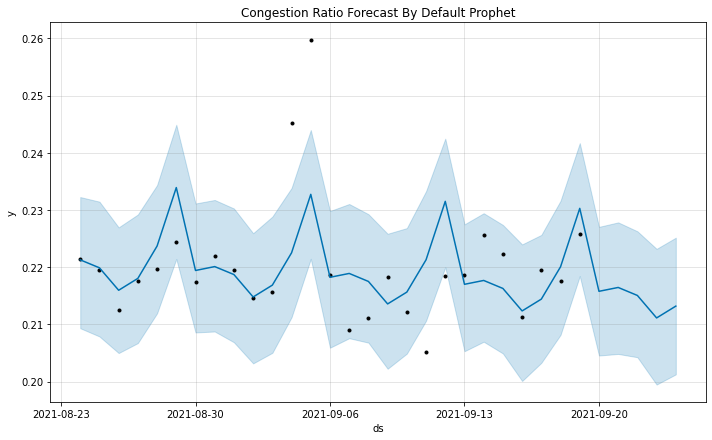

In [64]:
from prophet.plot import add_changepoints_to_plot
fig=m.plot(forecast)
plt.title('Congestion Ratio Forecast By Default Prophet')
fig.savefig('image/figP1.png', dpi=1000,bbox_inches="tight",pad_inches=0.1)

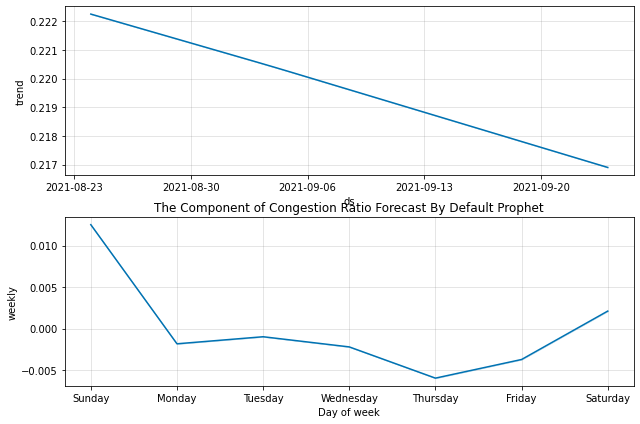

In [65]:
fig=m.plot_components(forecast)
plt.title('The Component of Congestion Ratio Forecast By Default Prophet')
fig.savefig('image/figP2.png', dpi=1000)

In [66]:
m2 = Prophet(holidays=drops)
m2 = m2.fit(df)
future2 = m2.make_future_dataframe(periods=5)
forecast2 = m2.predict(future2)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/723u62hy.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/xrsrfa5f.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=70700', 'data', 'file=/tmp/tmpnuhmry4c/723u62hy.json', 'init=/tmp/tmpnuhmry4c/xrsrfa5f.json', 'output', 'file=/tmp/tmpnuhmry4c/prophet_model7r8e459b/prophet_model-20221218205503.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
20:55:03 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:55:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

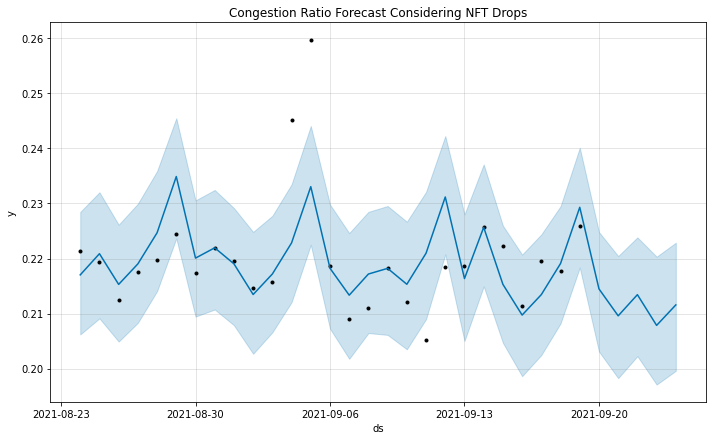

In [67]:
m2.plot(forecast2)
plt.title('Congestion Ratio Forecast Considering NFT Drops');

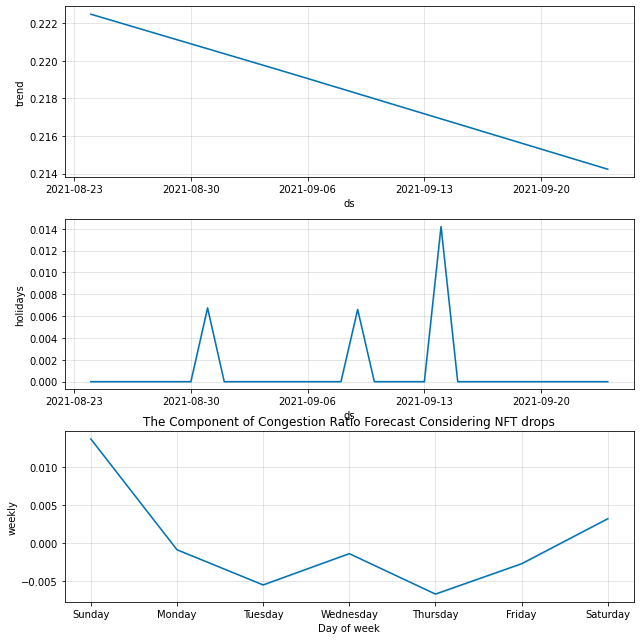

In [68]:
# Python
fig=m2.plot_components(forecast2)
plt.title('The Component of Congestion Ratio Forecast Considering NFT drops')
fig.savefig('image/figP3.png', dpi=1000,bbox_inches="tight",pad_inches=0.1)

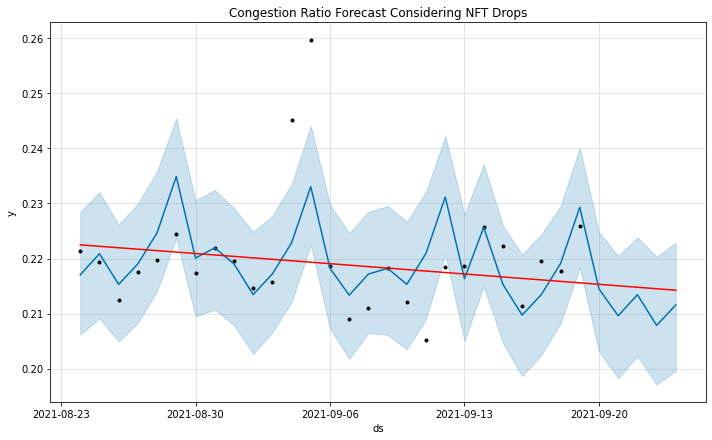

In [69]:
from prophet.plot import add_changepoints_to_plot
fig = m2.plot(forecast2)
a = add_changepoints_to_plot(fig.gca(), m2, forecast2)
plt.title('Congestion Ratio Forecast Considering NFT Drops')
fig.savefig('image/figP4.png', dpi=1000,bbox_inches="tight",pad_inches=0.1)

## Continued Congestion

In [70]:
#df = NFT.set_index('number', inplace = True)
df = date_c_congested_ratio
df.columns = ['ds','y']

In [71]:
m = Prophet()
m = m.fit(df)
future = m.make_future_dataframe(periods=5)
forecast = m.predict(future)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/m5vln0wm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/fkv26sw1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=82983', 'data', 'file=/tmp/tmpnuhmry4c/m5vln0wm.json', 'init=/tmp/tmpnuhmry4c/fkv26sw1.json', 'output', 'file=/tmp/tmpnuhmry4c/prophet_model8uzq8gw0/prophet_model-20221218205631.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
20:56:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:56:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

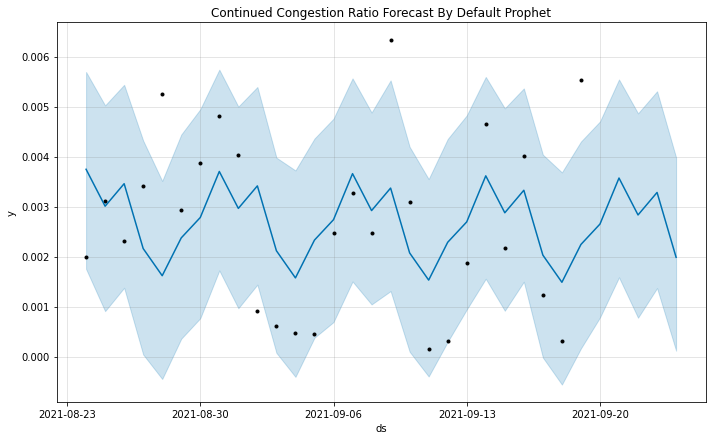

In [72]:
from prophet.plot import add_changepoints_to_plot
fig=m.plot(forecast)
plt.title('Continued Congestion Ratio Forecast By Default Prophet')
fig.savefig('image/figP5.png', dpi=1000, figsize=(16,9),bbox_inches="tight",pad_inches=0.1)

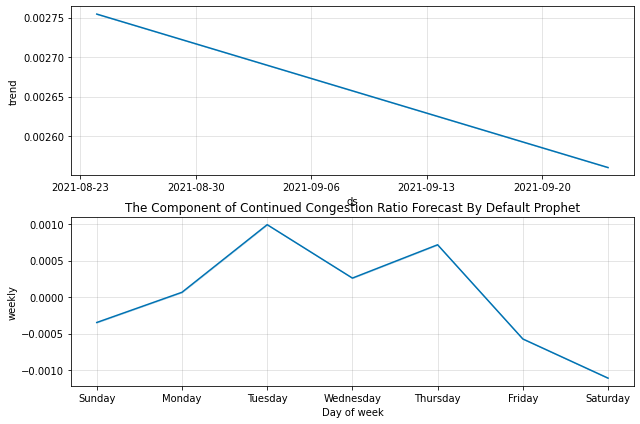

In [73]:
fig=m.plot_components(forecast)
plt.title('The Component of Continued Congestion Ratio Forecast By Default Prophet')
fig.savefig('image/figP6.png', dpi=1000, figsize=(16,9))

In [74]:
m2 = Prophet(holidays=drops)
m2 = m2.fit(df)
future2 = m2.make_future_dataframe(periods=5)
forecast2 = m2.predict(future2)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 20.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/dewurv8k.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpnuhmry4c/w2d15x0r.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=42499', 'data', 'file=/tmp/tmpnuhmry4c/dewurv8k.json', 'init=/tmp/tmpnuhmry4c/w2d15x0r.json', 'output', 'file=/tmp/tmpnuhmry4c/prophet_modelkcbc0xo5/prophet_model-20221218205938.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
20:59:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:59:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:c

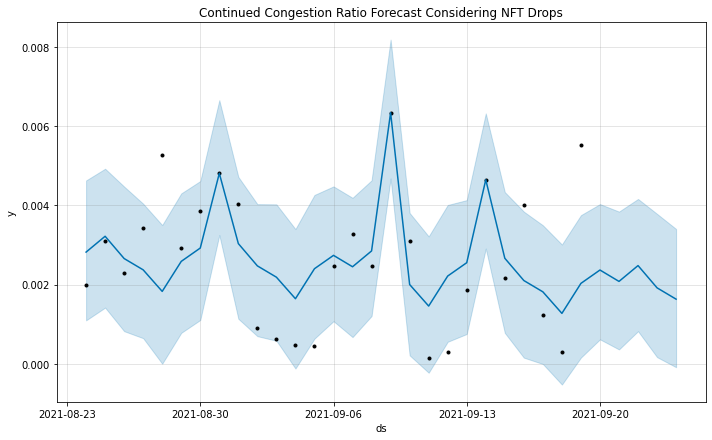

In [75]:
m2.plot(forecast2)
plt.title('Continued Congestion Ratio Forecast Considering NFT Drops');

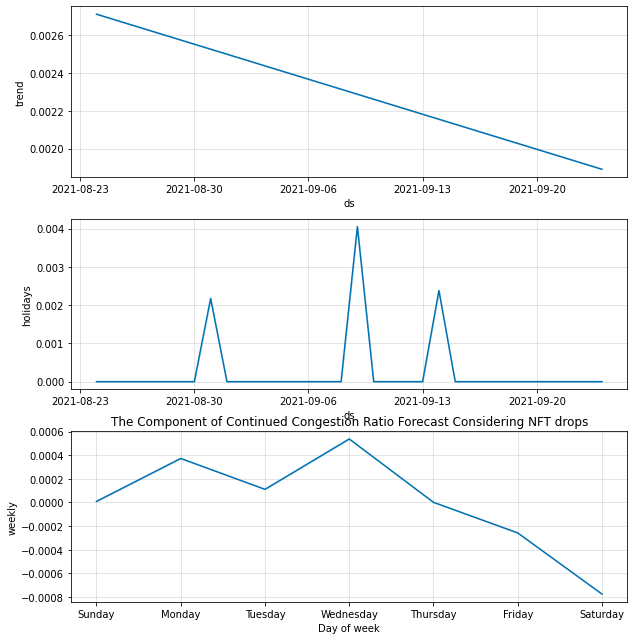

In [76]:
# Python
fig=m2.plot_components(forecast2)
plt.title('The Component of Continued Congestion Ratio Forecast Considering NFT drops')
fig.savefig('image/figP7.png', dpi=1000, figsize=(9,16))

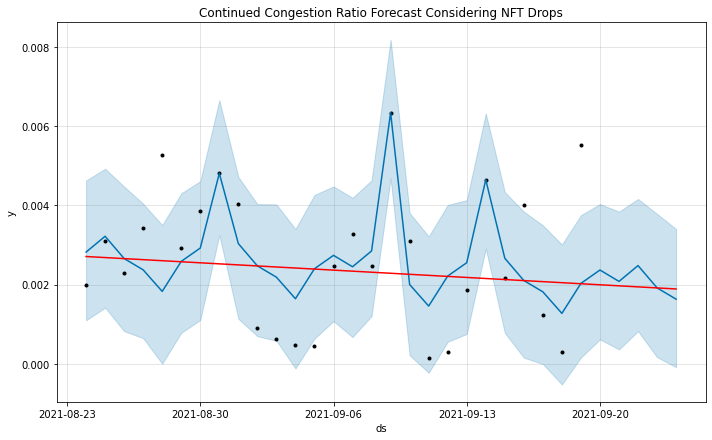

In [77]:
from prophet.plot import add_changepoints_to_plot
fig = m2.plot(forecast2)
a = add_changepoints_to_plot(fig.gca(), m2, forecast2)
plt.title('Continued Congestion Ratio Forecast Considering NFT Drops')
fig.savefig('image/figP8.png', dpi=1000, figsize=(16,9),bbox_inches="tight",pad_inches=0.1)